# Predictive Delays in Commercial Flights

### Updated credit assignment

![Updated credit assignment on Monday.com](http://13.66.213.192/monday.png)

#### Fetch ADLS Mounting Directory

In [0]:
%run "../configurations/mounting"

In [0]:
# the above cell should result in a blob storage path:
team_blob_url

'abfss://w261datastore@w261adlsgen2.dfs.core.windows.net'

#### Read Data From Datalake
- Focus on Departure Delay and using 3M data and 12M data

In [0]:
# list all available joined flights data on ADLS 
display(dbutils.fs.ls(f'{team_blob_url}/OTPW_Flights/'))

path,name,size,modificationTime
abfss://w261datastore@w261adlsgen2.dfs.core.windows.net/OTPW_Flights/OTPW_12M/,OTPW_12M/,0,1689730705000
abfss://w261datastore@w261adlsgen2.dfs.core.windows.net/OTPW_Flights/OTPW_36M/,OTPW_36M/,0,1689731617000
abfss://w261datastore@w261adlsgen2.dfs.core.windows.net/OTPW_Flights/OTPW_3M/,OTPW_3M/,0,1689729402000
abfss://w261datastore@w261adlsgen2.dfs.core.windows.net/OTPW_Flights/OTPW_60M/,OTPW_60M/,0,1689732611000


In [0]:
import pyspark.sql.types as T
import pyspark.sql.functions as F
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

sns.set()

In [0]:
# ingest 3 months time windowed flgihts data
df_flights_3M = spark.read.format('parquet')\
            .option("inferSchema", True)\
            .load(f"{team_blob_url}/OTPW_Flights/OTPW_3M")


# ingest 12 months time windowed flgihts data
df_flights_12M = spark.read.format('parquet')\
            .option("inferSchema", True)\
            .load(f"{team_blob_url}/OTPW_Flights/OTPW_12M")

# df_flights_3M.display(), df_flights_12M.display()

# Abstract & Problem Statement

For this iteration we decided to approach the problem from the perspective of the consumer, the passeners, which is also the primary stakeholder of our project. The goal of our analysis will be to predict whether a flight will be delayed so the paseengers can be notified well in advance saving the extra time they may end up spending at the airport in case of a departure delay. Thus, we will be focuing our effort on binary classification of flight departure delay across airports and carriers. Here, we define delay as a 15 minutes or greater from the flight schedule departure time. If such a case exists for a particular flight, it will receive a label of 1, else 0. We hypothesized that a combination of weather conditions, airport grouped by flight volumes, and carrier grouped by flight volumnes affect the departure delay. To assert such effect, we measured each of our features effect on the binary condition. Finally, we fitted our data onto a logistic regression model and a binary decision tree on our transformed features on the 80% training samples and test it on 20% of the held out samples. For this baseline iteration, our fitted logisitic regression yield 80% accuracy on the testing sample. Over the next few iterations, we will be adding more engineered features and extend our model by perfoming cross-validation and hyper-parameter tuning. 


In this phase of the project, our main goal was to tackle the problem of flight delays from the perspective of passengers, the primary stakeholders. We aimed to predict flight departure delays to provide passengers with advance notification and minimize inconvenience caused by potential delays. Our approach involved binary classification, categorizing flights as delayed (1) or on time (0) based on a 15-minute threshold from the scheduled departure time. We focused on three key factors that may impact delays: weather conditions, airport characteristics, and carrier-specific flight volumes. To validate our hypothesis, we conducted rigorous experiments using logistic regression and a binary decision tree as our main methods.

Our findings revealed that the combination of engineered features and model selection significantly influenced the predictive performance. The best pipeline comprised of feature engineering using weather data and airport information, followed by logistic regression for binary classification. The model achieved an accuracy of 80% on the testing dataset, showcasing its potential for effective prediction.

In the next steps of the project, we plan to enhance the model's predictive power through the addition of more engineered features and advanced modeling techniques, such as ensemble methods and gradient boosting. Furthermore, we will perform cross-validation and hyperparameter tuning to improve generalization and robustness. Our ultimate aim is to create a powerful and reliable predictive model that aids passengers in planning their travel efficiently and ensures a seamless travel experience by minimizing departure delays.

# EDA

#### EDA on 3 Months Data

Understand the information available in flight and weather data. Understand patterns of departure delays and identify features that may impact the probbality of a flight departure getting delayed.

In [0]:
#TODO: dig into some columns NaN on weather and flights etc.
df_flights_3M.columns

['QUARTER',
 'DAY_OF_MONTH',
 'DAY_OF_WEEK',
 'FL_DATE',
 'OP_UNIQUE_CARRIER',
 'OP_CARRIER_AIRLINE_ID',
 'OP_CARRIER',
 'TAIL_NUM',
 'OP_CARRIER_FL_NUM',
 'ORIGIN_AIRPORT_ID',
 'ORIGIN_AIRPORT_SEQ_ID',
 'ORIGIN_CITY_MARKET_ID',
 'ORIGIN',
 'ORIGIN_CITY_NAME',
 'ORIGIN_STATE_ABR',
 'ORIGIN_STATE_FIPS',
 'ORIGIN_STATE_NM',
 'ORIGIN_WAC',
 'DEST_AIRPORT_ID',
 'DEST_AIRPORT_SEQ_ID',
 'DEST_CITY_MARKET_ID',
 'DEST',
 'DEST_CITY_NAME',
 'DEST_STATE_ABR',
 'DEST_STATE_FIPS',
 'DEST_STATE_NM',
 'DEST_WAC',
 'CRS_DEP_TIME',
 'DEP_TIME',
 'DEP_DELAY',
 'DEP_DELAY_NEW',
 'DEP_DEL15',
 'DEP_DELAY_GROUP',
 'DEP_TIME_BLK',
 'TAXI_OUT',
 'WHEELS_OFF',
 'WHEELS_ON',
 'TAXI_IN',
 'CRS_ARR_TIME',
 'ARR_TIME',
 'ARR_DELAY',
 'ARR_DELAY_NEW',
 'ARR_DEL15',
 'ARR_DELAY_GROUP',
 'ARR_TIME_BLK',
 'CANCELLED',
 'CANCELLATION_CODE',
 'DIVERTED',
 'CRS_ELAPSED_TIME',
 'ACTUAL_ELAPSED_TIME',
 'AIR_TIME',
 'FLIGHTS',
 'DISTANCE',
 'DISTANCE_GROUP',
 'CARRIER_DELAY',
 'WEATHER_DELAY',
 'NAS_DELAY',
 'SECURITY_DEL

In [0]:
# Count unique values in some key variables in flight information
from pyspark.sql.functions import countDistinct
df_flights_3M.select(countDistinct('YEAR'), 
                     countDistinct('MONTH'), 
                     countDistinct('ORIGIN_STATE_NM'), 
                     countDistinct('ORIGIN_AIRPORT_ID'), 
                     countDistinct('DEST_AIRPORT_ID'), 
                     countDistinct('OP_UNIQUE_CARRIER')).show()

+--------------------+---------------------+-------------------------------+---------------------------------+-------------------------------+---------------------------------+
|count(DISTINCT YEAR)|count(DISTINCT MONTH)|count(DISTINCT ORIGIN_STATE_NM)|count(DISTINCT ORIGIN_AIRPORT_ID)|count(DISTINCT DEST_AIRPORT_ID)|count(DISTINCT OP_UNIQUE_CARRIER)|
+--------------------+---------------------+-------------------------------+---------------------------------+-------------------------------+---------------------------------+
|                   1|                    3|                             53|                              313|                            315|                               14|
+--------------------+---------------------+-------------------------------+---------------------------------+-------------------------------+---------------------------------+



#####Get the percentage of missing values from each column:

In [0]:
# Get the total number of rows in the DataFrame
total_rows = df_flights_3M.count()

# Calculate the percentage of null values for each column and filter out columns with no missing values
null_percentages = [
    (column_name, (null_count / total_rows) * 100)
    for column_name in df_flights_3M.columns
    if (null_count := df_flights_3M.filter(F.col(column_name).isNull()).count()) > 0
]

# Create a new DataFrame to store the results
df_flights_3M_na = spark.createDataFrame(null_percentages, ["Column", "NullPercentage"])

# Show the result DataFrame
df_flights_3M_na.display()

Column,NullPercentage
TAIL_NUM,0.5842169373674059
DEP_TIME,3.0189180105368845
DEP_DELAY,3.0189180105368845
DEP_DELAY_NEW,3.0189180105368845
DEP_DEL15,3.0189180105368845
DEP_DELAY_GROUP,3.0189180105368845
TAXI_OUT,3.0769329574136037
WHEELS_OFF,3.0769329574136037
WHEELS_ON,3.1623497980180724
TAXI_IN,3.1623497980180724


- Columns with over 25% missing data will be dropped
- For our initial work, rows missing values from columns of interest will be dropped. We will consider imputation in the future, if needed.

In [0]:
#Airports with highest departure delays
#ORD, ATL, DFW, DEN, LAX have the highest delays both departure and arrival
#display(df_flights_3M.groupBy('ORIGIN').agg(F.sum('DEP_DEL15').alias('total_delays')))

display(df_flights_3M.groupBy('ORIGIN').agg(F.sum('DEP_DEL15').alias('total_delays')).orderBy('total_delays', ascending=False))


ORIGIN,total_delays
ORD,20767.0
ATL,15918.0
DFW,15361.0
DEN,13167.0
LAX,10013.0
LGA,7602.0
IAH,7566.0
SFO,7365.0
PHX,7184.0
LAS,7068.0


In [0]:
#Airports with highest arrival delays
#ORD, ATL, DFW, DEN, LAX have the highest delays both departure and arrival
#display(df_flights_3M.groupBy('DEST').sum('ARR_DEL15'))

display(df_flights_3M.groupBy('DEST').sum('ARR_DEL15').orderBy('sum(ARR_DEL15)', ascending=False))


DEST,sum(ARR_DEL15)
ORD,18525.0
DFW,14248.0
ATL,14169.0
DEN,10781.0
LAX,10732.0
LGA,8790.0
SFO,8196.0
IAH,7585.0
BOS,6898.0
MCO,6646.0


In [0]:
#Arrival and departure delays by month
display(df_flights_3M.groupBy('MONTH').sum('DEP_DEL15', 'ARR_DEL15'))

MONTH,sum(DEP_DEL15),sum(ARR_DEL15)
1,90796.0,95805.0
3,95368.0,95241.0
2,91138.0,95029.0


In [0]:
#States with maximum departure delays
display(df_flights_3M.groupBy('ORIGIN_STATE_ABR').sum('DEP_DEL15').orderBy('sum(DEP_DEL15)', ascending=False))

ORIGIN_STATE_ABR,sum(DEP_DEL15)
TX,35184.0
CA,30703.0
IL,26511.0
FL,24869.0
NY,16608.0
GA,16532.0
CO,14639.0
AZ,7926.0
NV,7597.0
MI,7335.0


Databricks visualization. Run in Databricks to view.

In [0]:
#States with maximum arrival delays

display(df_flights_3M.groupBy('DEST_STATE_ABR').sum('ARR_DEL15').orderBy('sum(ARR_DEL15)', ascending=False))

DEST_STATE_ABR,sum(ARR_DEL15)
TX,34807.0
CA,32532.0
FL,25739.0
IL,23263.0
NY,18439.0
GA,14897.0
CO,12546.0
VA,7678.0
AZ,7673.0
MI,7316.0


Databricks visualization. Run in Databricks to view.

In [0]:
#biggest delay factors are Carrier_Delay and NAS_delay 
display(df_flights_3M.select(F.sum('CARRIER_DELAY'), 
                     F.sum('WEATHER_DELAY'), 
                     F.sum('NAS_DELAY'),
                     F.sum('SECURITY_DELAY'), 
                     F.sum('LATE_AIRCRAFT_DELAY')))

sum(CARRIER_DELAY),sum(WEATHER_DELAY),sum(NAS_DELAY),sum(SECURITY_DELAY),sum(LATE_AIRCRAFT_DELAY)
5229543.0,902952.0,3852712.0,17813.0,6480673.0


In [0]:
#The delay duration values are highly skewed
df_flights_3M.select('CARRIER_DELAY', 'WEATHER_DELAY',  'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY').describe().toPandas()

,summary,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY
0,count,286075,286075,286075,286075,286075
1,mean,18.28032159398759,3.156347111771389,13.46748929476536,0.062266888053832035,22.653755134143143
2,stddev,46.30342782930482,22.354988562240784,25.75955355017594,1.9538552003921454,41.81283206343031
3,min,0.0,0.0,0.0,0.0,0.0
4,max,1971.0,1152.0,1101.0,241.0,1313.0


In [0]:
# flight to delay ratio by carrier
df_flights_delay_ratio_3M = df_flights_3M.groupby('OP_UNIQUE_CARRIER')\
                                    .agg(F.sum('DEP_DEL15').alias('no_delays'),
                                         F.count('DEP_DEL15').alias('no_flights'))\
                                    .withColumn('delay_to_flights_ratio',F.col('no_delays')/F.col('no_flights')).cache()

df_flights_delay_ratio_3M_pandas = df_flights_delay_ratio_3M.to_pandas_on_spark().sort_values('delay_to_flights_ratio', ascending=False)
df_flights_delay_ratio_3M_pandas.plot.bar(x='OP_UNIQUE_CARRIER', y='delay_to_flights_ratio', title="Carriers Delay to Flight Ratios")


/databricks/spark/python/pyspark/sql/dataframe.py:5567: FutureWarning: DataFrame.to_pandas_on_spark is deprecated. Use DataFrame.pandas_api instead.
  warnings.warn(


In [0]:
# flight to delay ratio by airport
df_flights_delay_ratio_3M = df_flights_3M.groupby('origin_iata_code')\
                                    .agg(F.sum('DEP_DEL15').alias('no_delays'),
                                         F.count('DEP_DEL15').alias('no_flights'))\
                                    .withColumn('delay_to_flights_ratio',F.col('no_delays')/F.col('no_flights')).cache()

df_flights_delay_ratio_3M_pandas = df_flights_delay_ratio_3M.to_pandas_on_spark().sort_values('delay_to_flights_ratio').tail(10)
df_flights_delay_ratio_3M_pandas.plot.bar(x='delay_to_flights_ratio', y='origin_iata_code', title="Airport to Flight Ratios")

/databricks/spark/python/pyspark/sql/dataframe.py:5567: FutureWarning:

DataFrame.to_pandas_on_spark is deprecated. Use DataFrame.pandas_api instead.



# Features Selection

## Weather Features Selection

Weather are an important factor that could contribute to a flight delay. Here we oped to select a few weather features and visualize it distributions with the flight delays. All weather features we selected were cast into float type from it original string type. The few selected features are:
1. HourlyPrecipitation
2. HourlyDryBulbTemperature
3. HourlyPressureChange
4. HourlyRelativeHumidity
5. HourlySeaLevelPressure
6. HourlyStationPressure
7. HourlyVisibility
8. HourlyWindGustSpeed
9. HourlyWindSpeed

We utilize a box plot to represent each one of these weather features against the at least 15 minutes departure delay indicator DEP_DEL15. The first thing we noticed is that each one of these feature have a different scale. Visibly, HourlyDryBulbTemperature and HourlyRelativeHumidity shows an effect on departure delay at their original scale. However, we would need to normalize these features before using them for modeling. 

Of the 1,401,363 in the three months dataset there are a lot of Null Values for the collected temperature. Noted here that HourlyPressureChange and HourlyWindGustSpeed null values made up a majority of the data. While imputation could be worthwile, we decided to not utilize these two columns in our model. For the rest of the features null values, we decided to drop them from this iteration. Doing so yield 1,088,005 total flights, which made up of 77.6% of the original dataset.

|HourlyPrecipitation|HourlyDryBulbTemperature|HourlyPressureChange|HourlyRelativeHumidity|HourlySeaLevelPressure|HourlyStationPressure|HourlyVisibility|HourlyWindGustSpeed|HourlyWindSpeed|
|-------------------|------------------------|--------------------|----------------------|----------------------|---------------------|----------------|-------------------|---------------|
|            256,806|                   5,073|             929,956|                 4,755|               153,574|                9,814|           6,201|          1,219,338|           4,671|

In [0]:
#Weather data fields have alphanumeric values, need to use only the numeric values
import numpy as np
import matplotlib.pyplot as plt
from pyspark.sql.functions import col

df_flights_3M_numeric = df_flights_3M.withColumn("HourlyPrecipitation", col("HourlyPrecipitation").cast("Float"))\
                                    .withColumn("HourlyDryBulbTemperature", col("HourlyDryBulbTemperature").cast("Float"))\
                                    .withColumn("HourlyPressureChange", col("HourlyPressureChange").cast("Float"))\
                                    .withColumn("HourlyRelativeHumidity", col("HourlyRelativeHumidity").cast("Float"))\
                                    .withColumn("HourlySeaLevelPressure", col("HourlySeaLevelPressure").cast("Float"))\
                                    .withColumn("HourlyStationPressure", col("HourlyStationPressure").cast("Float"))\
                                    .withColumn("HourlyVisibility", col("HourlyVisibility").cast("Float"))\
                                    .withColumn("HourlyWindGustSpeed", col("HourlyWindGustSpeed").cast("Float"))\
                                    .withColumn("HourlyWindSpeed", col("HourlyWindSpeed").cast("Float")).cache()

df_flights_12M_numeric = df_flights_12M.withColumn("HourlyPrecipitation", col("HourlyPrecipitation").cast("Float"))\
                                    .withColumn("HourlyDryBulbTemperature", col("HourlyDryBulbTemperature").cast("Float"))\
                                    .withColumn("HourlyPressureChange", col("HourlyPressureChange").cast("Float"))\
                                    .withColumn("HourlyRelativeHumidity", col("HourlyRelativeHumidity").cast("Float"))\
                                    .withColumn("HourlySeaLevelPressure", col("HourlySeaLevelPressure").cast("Float"))\
                                    .withColumn("HourlyStationPressure", col("HourlyStationPressure").cast("Float"))\
                                    .withColumn("HourlyVisibility", col("HourlyVisibility").cast("Float"))\
                                    .withColumn("HourlyWindGustSpeed", col("HourlyWindGustSpeed").cast("Float"))\
                                    .withColumn("HourlyWindSpeed", col("HourlyWindSpeed").cast("Float")).cache()

<AxesSubplot:title={'center':'HourlyWindSpeed'}, xlabel='[DEP_DEL15]'>

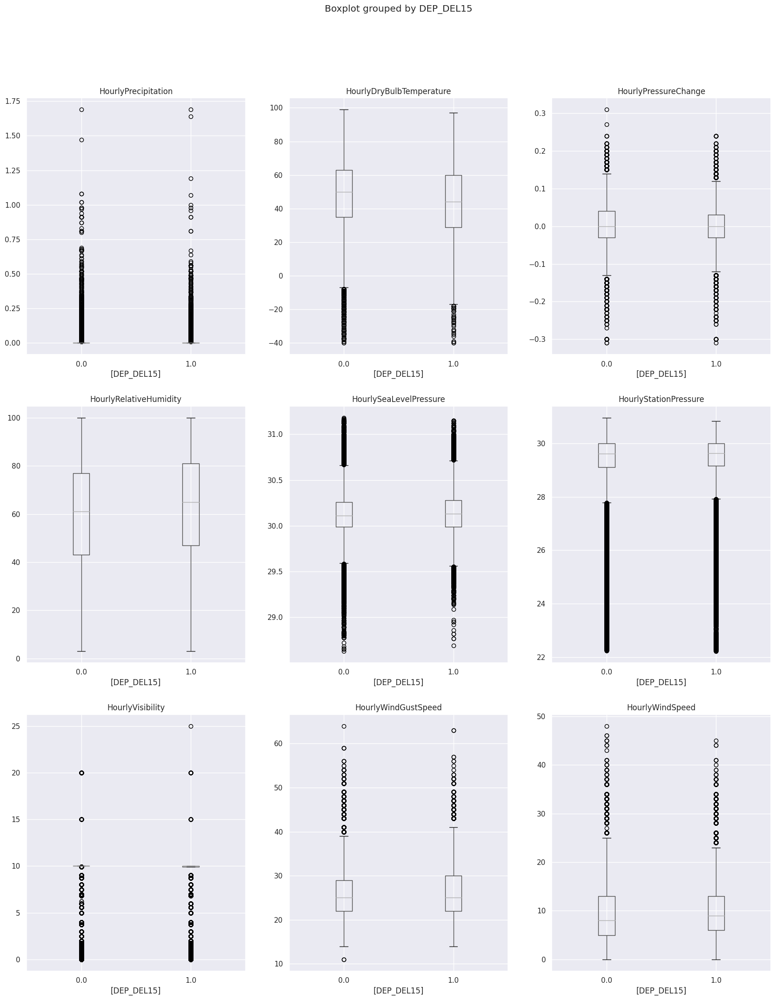

In [0]:
#Distribution of departure delay status by Weather factors 
fig, ax = plt.subplots(3,3, figsize=(20,25))
df_flights_3M_numeric.select('HourlyPrecipitation', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[0][0])
df_flights_3M_numeric.select('HourlyDryBulbTemperature', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[0][1])
df_flights_3M_numeric.select('HourlyPressureChange', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[0][2])
df_flights_3M_numeric.select('HourlyRelativeHumidity', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[1][0])
df_flights_3M_numeric.select('HourlySeaLevelPressure', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[1][1])
df_flights_3M_numeric.select('HourlyStationPressure', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[1][2])
df_flights_3M_numeric.select('HourlyVisibility', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[2][0])
df_flights_3M_numeric.select('HourlyWindGustSpeed', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[2][1])
df_flights_3M_numeric.select('HourlyWindSpeed', 'DEP_DEL15').toPandas().boxplot(by='DEP_DEL15', ax = ax[2][2])

In [0]:
# visualize the amount of Nulls for weather columns
weather_cols = ["HourlyPrecipitation", "HourlyDryBulbTemperature", 
                "HourlyPressureChange", "HourlyRelativeHumidity",
                "HourlySeaLevelPressure", "HourlyStationPressure",
                "HourlyVisibility", "HourlyWindGustSpeed","HourlyWindSpeed"]


# get number of records
print(f"Total Number of Flights: {df_flights_3M_numeric.count()}")
display(df_flights_3M_numeric.select([F.count(F.when(F.isnan(c) | F.col(c).isNull(), c)).alias(c) for c in weather_cols]))

Total Number of Flights: 1401363


HourlyPrecipitation,HourlyDryBulbTemperature,HourlyPressureChange,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWindGustSpeed,HourlyWindSpeed
256806,5073,929956,4755,153574,9814,6201,1219338,4671


In [0]:
# filter out Null values from our dataset (3M)
non_numeric_cols = ["OP_UNIQUE_CARRIER", "origin_airport_name", "origin_iata_code", "origin_type", "DEP_DEL15"]
df_flights_3M_numeric_non_null = df_flights_3M_numeric.select(non_numeric_cols + weather_cols).drop(*['HourlyPressureChange', 'HourlyWindGustSpeed']).na.drop().cache()
print(f"Total Number of Flights (Non Null): {df_flights_3M_numeric_non_null.count()}")

Total Number of Flights (Non Null): 1088005


In [0]:
# filter out Null values from our dataset (12M)
non_numeric_cols = ["OP_UNIQUE_CARRIER", "origin_airport_name", "origin_iata_code", "origin_type", "DEP_DEL15"]
df_flights_12M_numeric_non_null = df_flights_12M_numeric.select(non_numeric_cols + weather_cols).drop(*['HourlyPressureChange', 'HourlyWindGustSpeed']).na.drop().cache()
print(f"Total Number of Flights (Non Null): {df_flights_12M_numeric_non_null.count()}")

Total Number of Flights (Non Null): 4678860


## Date & Time feature Selection

We performed feature engineering to enhance our dataset by adding an 'IS_HOLIDAY' column, which identifies whether a given date is a holiday or not. This allowed us to investigate how flight delays are impacted during holiday periods.

To better understand the relationship between flight delays and time of day, we created a new feature 'TIME_SLOT' by grouping departure times into different time blocks. The 'TIME_SLOT' feature enabled us to analyze the average delay per flight for each specific time block.

To study the variation in flight delays across different days of the week, we engineered the 'DAY_OF_WEEK' feature. By calculating the average delay per flight for each day of the week, we gained valuable insights into the impact of the day of travel on flight punctuality.

The significance of departure time blocks was explored by examining the average delayed flight percentage for each specific block. This analysis helped us understand the relationship between flight delays and the specific periods of the day, aiding us in optimizing our flight scheduling strategies.

## Holiday

In [0]:
#Install the holidays library if not already installed
!pip install holidays

#Import the required libraries
import pandas as pd
from datetime import date
import holidays
from pyspark.sql.types import BooleanType
from pyspark.sql.types import IntegerType

#Create a list of years from 2015 to the current year
current_year = date.today().year
years = list(range(2015, current_year + 1))

#Initialize the UnitedStates class from the holidays library
us_holidays = holidays.UnitedStates(years=years)

#Create a DataFrame to store the holiday dates
#holiday_dates = pd.DataFrame({'holiday_date': list(us_holidays.keys())})

# Extract the list of holiday dates as strings in 'yyyy-mm-dd' format
holiday_dates = [str(holiday_date) for holiday_date in us_holidays.keys()]

#Display the first few rows of the holiday dates DataFrame
#display(holiday_dates.head())

# def is_holiday(date_str):
#     return date_str in holiday_dates

# # Register the UDF with Spark
# is_holiday_udf = F.udf(is_holiday, BooleanType())

def is_holiday(date_str):
    return 1 if date_str in holiday_dates else 0

# Register the UDF with Spark
is_holiday_udf = F.udf(is_holiday, IntegerType())


[notice] A new release of pip available: 22.2.2 -> 23.2.1
[notice] To update, run: pip install --upgrade pip


In [0]:
# Add new hoiday column to dataframe
df_flights_3M = df_flights_3M.withColumn('IS_HOLIDAY', is_holiday_udf(F.date_format('FL_DATE', 'yyyy-MM-dd')))


## Holiday Rush 
Two days before and after holiday is set as 1

In [0]:
# Add the 'HOLIDAY_RUSH' column to the DataFrame
df_flights_3M = df_flights_3M.withColumn('HOLIDAY_RUSH', F.when(
    (is_holiday_udf(F.date_format(F.date_sub(df_flights_3M['FL_DATE'], 1), 'yyyy-MM-dd')) == 1) |
    (is_holiday_udf(F.date_format(F.date_sub(df_flights_3M['FL_DATE'], 2), 'yyyy-MM-dd')) == 1) |
    (is_holiday_udf(F.date_format(F.date_add(df_flights_3M['FL_DATE'], 1), 'yyyy-MM-dd')) == 1) |
    (is_holiday_udf(F.date_format(F.date_add(df_flights_3M['FL_DATE'], 2), 'yyyy-MM-dd')) == 1) |
    (is_holiday_udf(F.date_format(df_flights_3M['FL_DATE'], 'yyyy-MM-dd')) == 1),
    1
).otherwise(0))


In [0]:

# Compute the total flight count grouped by 'IS_HOLIDAY'
total_flight_count = df_flights_3M.groupBy('IS_HOLIDAY').agg(
    F.count('*').alias('total_flight_count')
)

# Group by 'IS_HOLIDAY' and sum 'DEP_DELAY' where 'DEP_DEL15' is 1
df_holiday_delays = df_flights_3M.where(F.col('DEP_DEL15') == 1).groupBy('IS_HOLIDAY').agg(
    F.sum('DEP_DEL15').alias('delayed_flight_count')
)

# Join the two DataFrames on 'IS_HOLIDAY'
df_holiday_delays = df_holiday_delays.join(total_flight_count, on='IS_HOLIDAY', how='left')

# Calculate the average delay per flight on holidays
df_holiday_delays = df_holiday_delays.withColumn('delayed_flight_pct',
    F.round(df_holiday_delays['delayed_flight_count'] / df_holiday_delays['total_flight_count'] * 100, 3)
)

# Order by 'total_delays' in descending order
df_holiday_delays = df_holiday_delays.orderBy('delayed_flight_pct', ascending=False)

# Display the DataFrame
display(df_holiday_delays)


IS_HOLIDAY,delayed_flight_count,total_flight_count,delayed_flight_pct
1,9568.0,46026,20.788
0,267734.0,1355337,19.754


## Departure Time Block

In [0]:

# Compute total flight count grouped by 'DEP_TIME_BLK'
total_flight_count = df_flights_3M.groupBy('DEP_TIME_BLK').agg(
    F.count('*').alias('total_flights')
)

# Compute total delayed flights count where 'DEP_DEL15' is 1 grouped by 'DEP_TIME_BLK'
time_blk_delays_df = df_flights_3M.where(F.col('DEP_DEL15') == 1).groupBy('DEP_TIME_BLK').agg(
    F.sum('DEP_DEL15').alias('total_delayed_flights')
)

# Join the two DataFrames on 'DEP_TIME_BLK'
time_blk_delays_df = time_blk_delays_df.join(
    total_flight_count, on='DEP_TIME_BLK', how='left'
)

# Calculate the average delayed flights per time block
time_blk_delays_df = time_blk_delays_df.withColumn('delayed_flight_pct',
    F.round(time_blk_delays_df['total_delayed_flights'] / time_blk_delays_df['total_flights'] * 100,3)
)

# Order by 'total_delays' in descending order
time_blk_delays_df = time_blk_delays_df.orderBy('delayed_flight_pct', ascending=False)

# Display the DataFrame
display(time_blk_delays_df)

DEP_TIME_BLK,total_delayed_flights,total_flights,delayed_flight_pct
2000-2059,16694.0,59531,28.043
1900-1959,22398.0,80988,27.656
1800-1859,22002.0,79837,27.559
2100-2159,11455.0,43546,26.306
1700-1759,24747.0,97565,25.365
1600-1659,20921.0,83764,24.976
1500-1559,21300.0,88239,24.139
1400-1459,19137.0,82079,23.315
1300-1359,20110.0,93735,21.454
2200-2259,4706.0,22006,21.385


## Departure Time Slot

In [0]:
## Most number of flights are during 6am - 7am timeslot
## Most delay is during 5pm - 6pm timeslot
## As day progresses, delay increases

## We can create another timeslot variable with DEP_TIME_BLK grouped as below:
## morning : 0600-0659, 0700-0759, 0800-0859, 0900-0959
## mid-morning: 0900-0959, 1000-1059, 1100-1159
## afternoon : 1200-1259, 1300-1359, 1400-1459
## evening : 1500-1559, 1600-1659, 1700-1759, 1800-1859
## night: 1900-1959, 2000-2059, 2100-2159, 2200-2259, 2300-2359, 0001-0559,

# Define a UDF to map 'DEPT_TIME_BLK' to 'TIME_SLOT'
def map_time_slot(dept_time_blk):
    if dept_time_blk in ['0600-0659', '0700-0759', '0800-0859', '0900-0959']:
        return 'morning'
    elif dept_time_blk in ['1000-1059', '1100-1159']:
        return 'mid-morning'
    elif dept_time_blk in ['1200-1259', '1300-1359', '1400-1459']:
        return 'afternoon'
    elif dept_time_blk in ['1500-1559', '1600-1659', '1700-1759', '1800-1859']:
        return 'evening'
    elif dept_time_blk in ['1900-1959', '2000-2059', '2100-2159', '2200-2259', '2300-2359', '0001-0559']:
        return 'night'
    else:
        return 'unknown'

# Convert the UDF to a Spark UDF
map_time_slot_udf = F.udf(map_time_slot)

# Add the new 'TIME_SLOT' column based on 'DEPT_TIME_BLK'
df_flights_3M = df_flights_3M.withColumn('TIME_SLOT', map_time_slot_udf('DEP_TIME_BLK'))


In [0]:
# Compute total flight count grouped by 'TIME_SLOT'
total_flight_count = df_flights_3M.groupBy('TIME_SLOT').agg(
    F.count('*').alias('total_flights')
)

# Compute total delayed flights count where 'DEP_DEL15' is 1 grouped by 'TIME_SLOT'
time_slot_delays_df = df_flights_3M.where(F.col('DEP_DEL15') == 1).groupBy('TIME_SLOT').agg(
    F.sum('DEP_DEL15').alias('total_delayed_flights')
)

# Join the two DataFrames on 'TIME_SLOT'
time_slot_delays_df = time_slot_delays_df.join(
    total_flight_count, on='TIME_SLOT', how='left'
)

# Calculate the average delayed flights per time block
time_slot_delays_df = time_slot_delays_df.withColumn('delayed_flight_pct',
    F.round(time_slot_delays_df['total_delayed_flights'] / time_slot_delays_df['total_flights'] * 100,3)
)

# Order by 'total_delays' in descending order
time_slot_delays_df = time_slot_delays_df.orderBy('delayed_flight_pct', ascending=False)

# Display the DataFrame
display(time_slot_delays_df)


TIME_SLOT,total_delayed_flights,total_flights,delayed_flight_pct
evening,88970.0,349405,25.463
night,58937.0,240026,24.554
afternoon,56359.0,260205,21.659
mid-morning,32619.0,179001,18.223
morning,40417.0,372726,10.844


## Departure By Day

In [0]:
# Compute total flight count grouped by 'DAY_OF_WEEK'
total_flight_count = df_flights_3M.groupBy('DAY_OF_WEEK').agg(
    F.count('*').alias('total_flights')
)

# Compute total delayed flights count where 'DEP_DEL15' is 1 grouped by 'TIME_SLOT'
by_day_delays_df = df_flights_3M.where(F.col('DEP_DEL15') == 1).groupBy('DAY_OF_WEEK').agg(
    F.sum('DEP_DEL15').alias('total_delayed_flights')
)

# Join the two DataFrames on 'DAY_OF_WEEK'
by_day_delays_df = by_day_delays_df.join(
    total_flight_count, on='DAY_OF_WEEK', how='left'
)

# Calculate the average delayed flights per time block
by_day_delays_df = by_day_delays_df.withColumn('delayed_flight_pct',
    F.round(by_day_delays_df['total_delayed_flights'] / by_day_delays_df['total_flights'] * 100,3)
)

# Order by 'total_delays' in descending order
by_day_delays_df = by_day_delays_df.orderBy('delayed_flight_pct', ascending=False)

# Display the DataFrame
display(by_day_delays_df)


DAY_OF_WEEK,total_delayed_flights,total_flights,delayed_flight_pct
1,46615.0,212525,21.934
7,42594.0,196813,21.642
5,44637.0,213817,20.876
4,42544.0,210470,20.214
2,37247.0,204305,18.231
6,30726.0,171801,17.885
3,32939.0,191632,17.189


## Visualize Date & Time feature selection

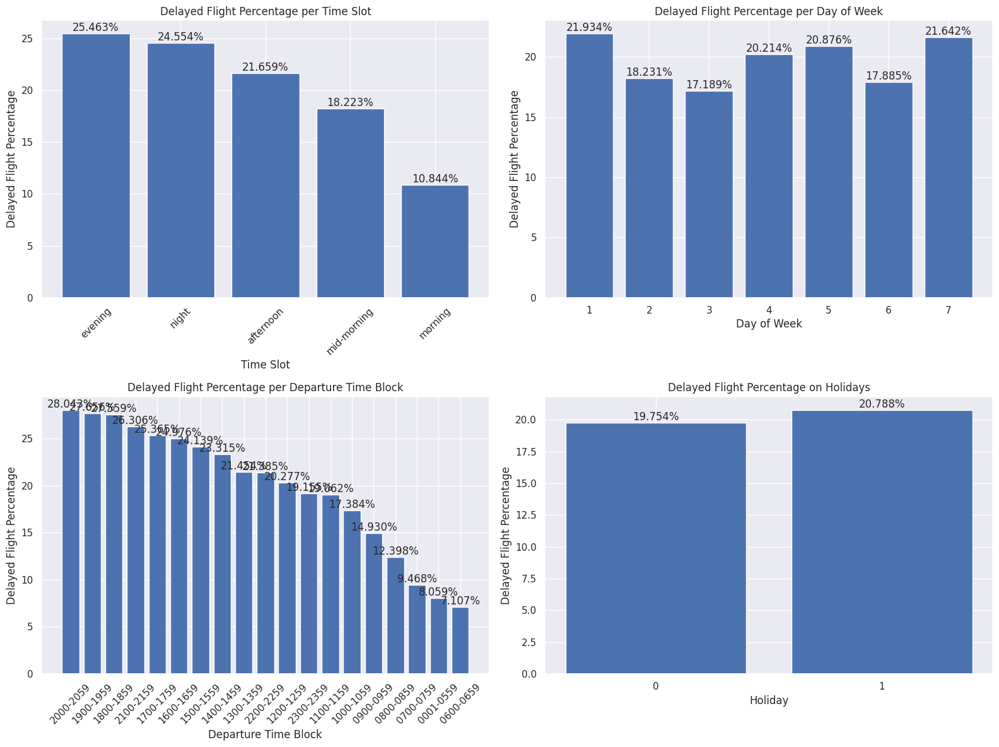

In [0]:
import matplotlib.pyplot as plt

# Extract the data for plotting
time_slots = time_slot_delays_df.select('TIME_SLOT').rdd.flatMap(lambda x: x).collect()
delayed_flight_pct_time_slot = time_slot_delays_df.select('delayed_flight_pct').rdd.flatMap(lambda x: x).collect()

days_of_week = by_day_delays_df.select('DAY_OF_WEEK').rdd.flatMap(lambda x: x).collect()
delayed_flight_pct_day = by_day_delays_df.select('delayed_flight_pct').rdd.flatMap(lambda x: x).collect()

dep_time_blks = time_blk_delays_df.select('DEP_TIME_BLK').rdd.flatMap(lambda x: x).collect()
delayed_flight_pct_time_blk = time_blk_delays_df.select('delayed_flight_pct').rdd.flatMap(lambda x: x).collect()

holidays = df_holiday_delays.select('IS_HOLIDAY').rdd.flatMap(lambda x: x).collect()
delayed_flight_pct_holiday = df_holiday_delays.select('delayed_flight_pct').rdd.flatMap(lambda x: x).collect()

# Create a single plot with subplots
fig, axs = plt.subplots(2, 2, figsize=(16, 12))

# Plot for time_slot_delays_df
axs[0, 0].bar(time_slots, delayed_flight_pct_time_slot)
axs[0, 0].set_xlabel('Time Slot')
axs[0, 0].set_ylabel('Delayed Flight Percentage')
axs[0, 0].set_title('Delayed Flight Percentage per Time Slot')

# Annotate each bar with its value
for i, bar in enumerate(axs[0, 0].patches):
    height = bar.get_height()
    axs[0, 0].text(bar.get_x() + bar.get_width() / 2, height, f'{delayed_flight_pct_time_slot[i]:.3f}%', ha='center', va='bottom')

axs[0, 0].tick_params(axis='x', rotation=45)   

# Plot for by_day_delays_df
axs[0, 1].bar(days_of_week, delayed_flight_pct_day)
axs[0, 1].set_xlabel('Day of Week')
axs[0, 1].set_ylabel('Delayed Flight Percentage')
axs[0, 1].set_title('Delayed Flight Percentage per Day of Week')

# Annotate each bar with its value
for i, bar in enumerate(axs[0, 1].patches):
    height = bar.get_height()
    axs[0, 1].text(bar.get_x() + bar.get_width() / 2, height, f'{delayed_flight_pct_day[i]:.3f}%', ha='center', va='bottom')

axs[0, 1].tick_params(axis='x', rotation=0)   

# Plot for time_blk_delays_df
axs[1, 0].bar(dep_time_blks, delayed_flight_pct_time_blk)
axs[1, 0].set_xlabel('Departure Time Block')
axs[1, 0].set_ylabel('Delayed Flight Percentage')
axs[1, 0].set_title('Delayed Flight Percentage per Departure Time Block')

# Annotate each bar with its value
for i, bar in enumerate(axs[1, 0].patches):
    height = bar.get_height()
    axs[1, 0].text(bar.get_x() + bar.get_width() / 2, height, f'{delayed_flight_pct_time_blk[i]:.3f}%', ha='center', va='bottom')

axs[1, 0].tick_params(axis='x', rotation=45)   

# Plot for df_holiday_delays
axs[1, 1].bar(holidays, delayed_flight_pct_holiday)
axs[1, 1].set_xlabel('Holiday')
axs[1, 1].set_ylabel('Delayed Flight Percentage')
axs[1, 1].set_title('Delayed Flight Percentage on Holidays')

# Annotate each bar with its value
for i, bar in enumerate(axs[1, 1].patches):
    height = bar.get_height()
    axs[1, 1].text(bar.get_x() + bar.get_width() / 2, height, f'{delayed_flight_pct_holiday[i]:.3f}%', ha='center', va='bottom')

axs[1, 1].tick_params(axis='x', rotation=0)   
axs[1, 1].set_xticks([0, 1])

plt.tight_layout()
plt.show()

## Season

In [0]:
# Define a UDF to map the month to the corresponding season
def get_season(month):
    if month in [12, 1, 2]:
        return 'winter'
    elif month in [3, 4, 5]:
        return 'spring'
    elif month in [6, 7, 8]:
        return 'summer'
    elif month in [9, 10, 11]:
        return 'fall'
    else:
        return 'unknown'

# Register the UDF with Spark
get_season_udf = F.udf(get_season, F.StringType())

# Add the 'season' column to the DataFrame
df_flights_3M = df_flights_3M.withColumn('SEASON', get_season_udf(F.col('MONTH')))

# Display the DataFrame to verify the new 'season' column
display(df_flights_3M)


QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitat

# Addressing Non-Numerical Data

Of the two dataset theres are 216 fields in total, 135 are non-numerics for 3 months and 136 are non-numerics for 12 months. The single column discrepancy between these two datasets is named "DailyMaximumDryBulbTemperature". This make up over 60% of the total dataset. Since our objective for this project is to predict whether or not a flight will experience delay, a lot of these non-numerics fields are not needed. It is noted that the "HourlySkyConditions" column in this dataset that provides a mixed of numerical values and non-numerical values. For simplicity we will emit this from this study. After a closer inspection, a lot of these columns either contained numerical data or a lot of null values that got mistakenly labled as non-numerics by Spark's inferSchema. For this studying, we identified the following non-numerical columns to be use in our analysis because we hypothesize that there is a relationship between airport and carrier on delay:

1. `OP_UNIQUE_CARRIER`: unique arline carrier id
2. `origin_airport_name`: name of the origin airport
3. `origin_iata_code`: origin airport 3 letters code
4. `origin_type`: type of airport at the origin

In [0]:
def summazize_non_numeric_data(df):
    non_integer_fields = []
    for field in df.schema.fields:
        if ((field.dataType == T.DateType()) or (field.dataType == T.StringType()) or (field.dataType == T.TimestampType())):
            non_integer_fields.append(field.name)

    print(f"Total Non-Numeric Fields: {len(non_integer_fields)}")
    print(f"Total Fields: {len(df.schema.fields)}")
    print(f"Percentage of Non-Numeric Fields: {round(len(non_integer_fields) / len(df.schema.fields) * 100, 2)}%")

    # add the indicator y variable
    non_integer_fields.append('DEP_DEL15')
    df_flights_non_numerics = df.select(*non_integer_fields).cache()

    return non_integer_fields, df_flights_non_numerics

In [0]:
# fetch all non-numeric type schema
print("3 Months Dataset:")
non_integer_fields_3M, df_flights_non_numerics_3M = summazize_non_numeric_data(df_flights_3M)
print("\n12 Months Dataset:")
non_integer_fields_12M, df_flights_non_numerics_12M = summazize_non_numeric_data(df_flights_12M)

3 Months Dataset:
Total Non-Numeric Fields: 137
Total Fields: 220
Percentage of Non-Numeric Fields: 62.27%

12 Months Dataset:
Total Non-Numeric Fields: 136
Total Fields: 216
Percentage of Non-Numeric Fields: 62.96%


In [0]:
# get column that is in 12M but not  in 3M
not_in = [x for x in non_integer_fields_12M if x not in non_integer_fields_3M]
print(f"Not Overlapping Features: {not_in}")

# select only the non-numeric fields
# df_flights_non_numerics_3M.display()

Not Overlapping Features: ['DailyMaximumDryBulbTemperature']


In [0]:
# slice the data on a few non-numeric fields and do some EDA on it
non_numeric_fields = ["OP_UNIQUE_CARRIER", "origin_airport_name", "origin_iata_code", "origin_type"]

df_flights_non_numerics_3M = df_flights_3M.select(*non_numeric_fields).cache()
df_flights_non_numerics_12M = df_flights_12M.select(*non_numeric_fields).cache()

#### Origin Airport Type
For our initial analysis, we decided to look in the type of airport. Here, we plot the fraction of airport type across all flights for the 3 Months flights data. From this analysis, large airport made up of 91.6% of the total dataset (medium made up 8.2%, and small made up 0.21%). For this reason, we decided to only focus on large airports for this iteration.

<Figure size 640x480 with 0 Axes>

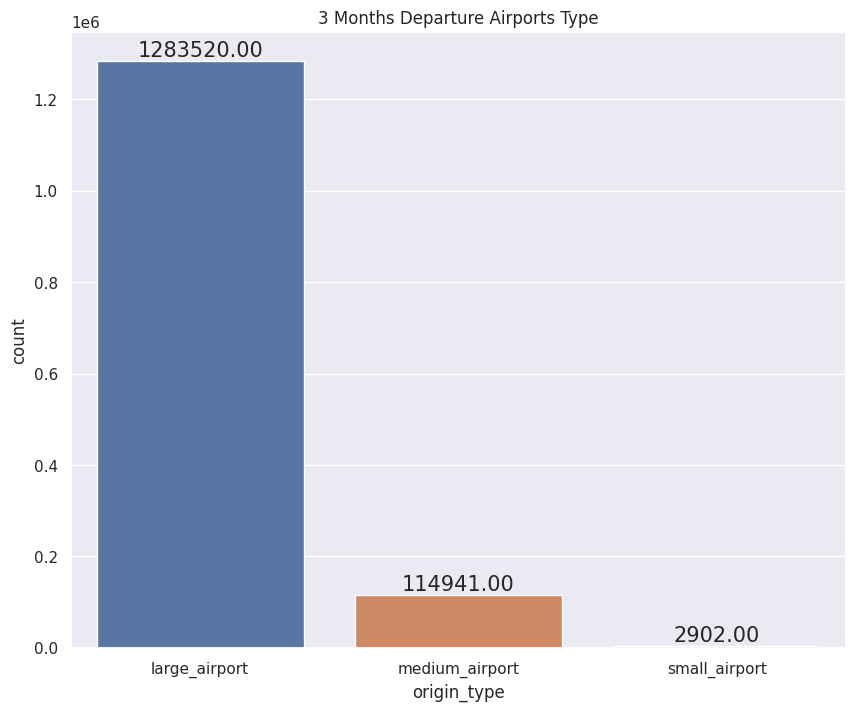

In [0]:
# plot airport origin type
origin_airport_types = df_flights_non_numerics_3M.select("origin_type").groupby('origin_type').count().toPandas()
plt.clf()
plt.figure(figsize=(10,8))
plots = sns.barplot(y = origin_airport_types['count'], x=origin_airport_types['origin_type'])

# Iterating over the bars one-by-one
# label the bar with the count of each bar
for bar in plots.patches:
    plots.annotate(format(bar.get_height(), ".2f"),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                    size=15, xytext=(0, 8),
                    textcoords='offset points')
    
plt.title(f"3 Months Departure Airports Type")
plt.show()

In [0]:
# Filtering out to only large departure
df_flights_3M_numeric_non_null = df_flights_3M_numeric_non_null.filter("origin_type = 'large_airport'")
df_flights_12M_numeric_non_null = df_flights_12M_numeric_non_null.filter("origin_type = 'large_airport'")

#### Origin Airport Departure by Carrier
When looking at the distribution of flight across airports, it seem like the data distribution is highly left skewed. We decided to divide our data into parititions based on quantiles to better group the airports by its flight volumnes. This grouping analysis and technique is applied on both the unique carrier number and the origin airport IATA code. Using the quantiles, we're able to group airport and carriers into four distinct groups. The breakdown can be interpreted as low flights volume (group B), mid-low flight volume (group C), mid-high flight volume (group D), and high flight volume (group D). Partitioning our data into these four groups yield approximately 25% of data, which equates to approximately 33-34 airports per group and 3-4 carriers per group. Partitiong our data this way emilimates the skewness in the total number of flights.. From here, we'll map the airport group and the carrier group to our dataset and performed One Hot Encoding techique to these two columns.

<AxesSubplot:title={'center':'distribution of flights volume'}, ylabel='Frequency'>

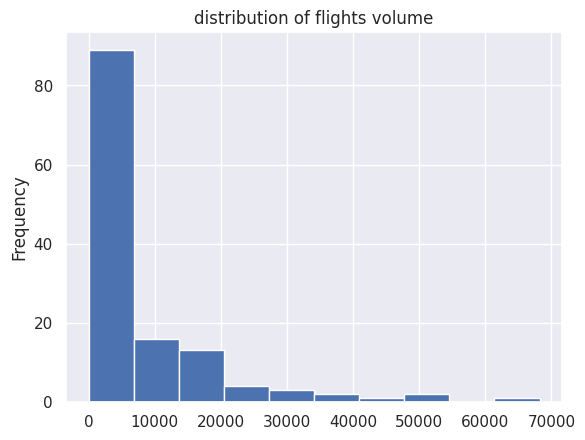

In [0]:
number_of_flights_3M = df_flights_3M_numeric_non_null.groupby('origin_iata_code').count()
number_of_flights_12M = df_flights_12M_numeric_non_null.groupby('origin_iata_code').count()
number_of_flights_3M.toPandas()['count'].plot.hist(bins=10, title='distribution of flights volume')

In [0]:
number_of_flights_3M.summary().show()

+-------+----------------+------------------+
|summary|origin_iata_code|             count|
+-------+----------------+------------------+
|  count|             131|               131|
|   mean|            null| 7660.297709923664|
| stddev|            null|11795.861528972226|
|    min|             ABQ|                 6|
|    25%|            null|               800|
|    50%|            null|              2152|
|    75%|            null|              9100|
|    max|             VPS|             68221|
+-------+----------------+------------------+



<Figure size 640x480 with 0 Axes>

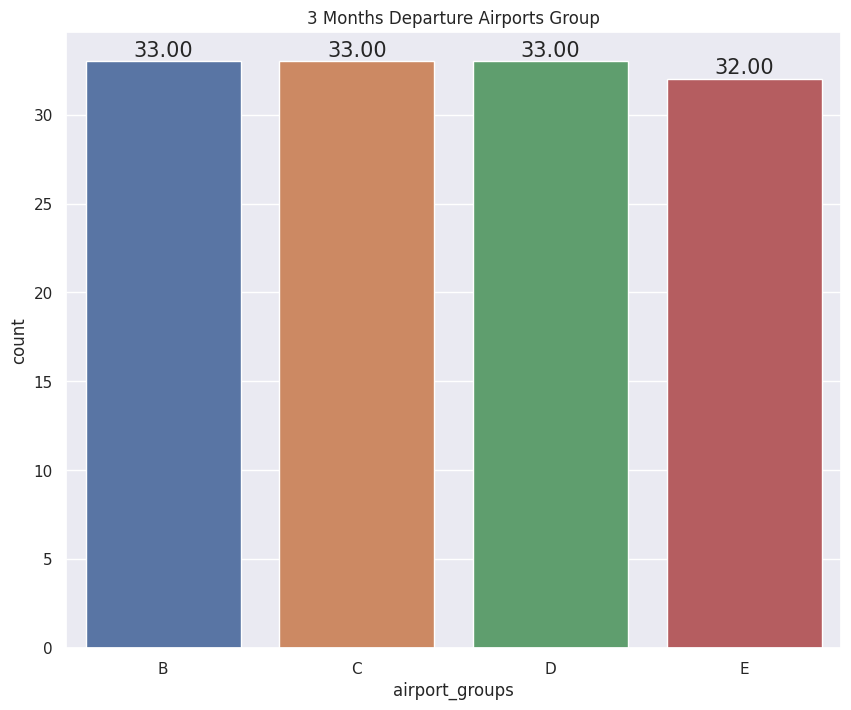

In [0]:
# Parititon the Airport into quantiles
airports_number_of_flights_3M = number_of_flights_3M.withColumn('airport_groups', F.when(F.col('count') < 6, 'A')\
                                                                        .when((F.col('count') >= 6) & ((F.col('count') <= 800)) , 'B')\
                                                                        .when((F.col('count') > 800) & ((F.col('count') <= 2152)) , 'C')\
                                                                        .when((F.col('count') > 2152) & ((F.col('count') <= 9200)) , 'D')\
                                                                        .otherwise('E'))
departure_airport_groups = airports_number_of_flights_3M.toPandas().groupby("airport_groups").count().reset_index()

plt.clf()
plt.figure(figsize=(10,8))
plots = sns.barplot(x = departure_airport_groups['airport_groups'], y = departure_airport_groups['count'])

# Iterating over the bars one-by-one
# label the bar with the count of each bar
for bar in plots.patches:
    plots.annotate(format(bar.get_height(), ".2f"),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                    size=15, xytext=(0, 8),
                    textcoords='offset points')

plt.title(f"3 Months Departure Airports Group")
plt.show()

In [0]:
number_of_flights_3M = df_flights_3M_numeric_non_null.groupby('OP_UNIQUE_CARRIER').count()
number_of_flights_12M = df_flights_12M_numeric_non_null.groupby('OP_UNIQUE_CARRIER').count()
number_of_flights_3M.summary().show()

+-------+-----------------+------------------+
|summary|OP_UNIQUE_CARRIER|             count|
+-------+-----------------+------------------+
|  count|               14|                14|
|   mean|             null|           71678.5|
| stddev|             null|62579.329073953435|
|    min|               AA|              8693|
|    25%|             null|             19139|
|    50%|             null|             49755|
|    75%|             null|             93772|
|    max|               WN|            233983|
+-------+-----------------+------------------+



<Figure size 640x480 with 0 Axes>

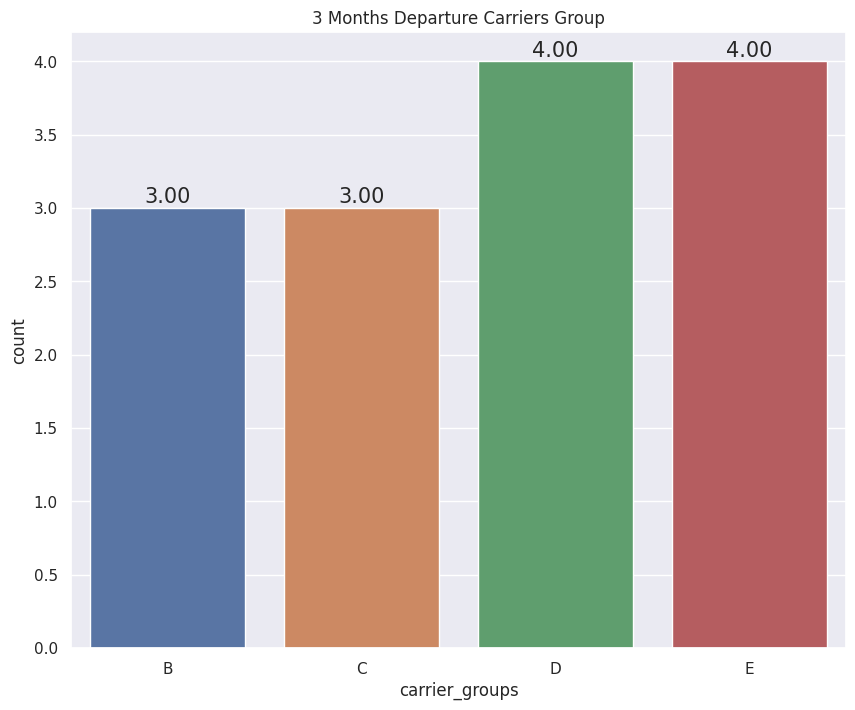

In [0]:
# Parititon the Airport into quantiles
carriers_number_of_flights_3M = number_of_flights_3M.withColumn('carrier_groups', F.when(F.col('count') < 8693, "A")\
                                                                        .when((F.col('count') >= 8693) & ((F.col('count') < 19139)) , "B")\
                                                                        .when((F.col('count') >= 19139) & ((F.col('count') < 49755)) ,"C")\
                                                                        .when((F.col('count') >= 49755) & ((F.col('count') < 93772)) , "D")\
                                                                        .otherwise('E'))

departure_carriers_groups = carriers_number_of_flights_3M.toPandas().groupby("carrier_groups").count().reset_index()
plt.clf()
plt.figure(figsize=(10,8))
plots = sns.barplot(x = departure_carriers_groups['carrier_groups'], y = departure_carriers_groups['count'])

# Iterating over the bars one-by-one
# label the bar with the count of each bar
for bar in plots.patches:
    plots.annotate(format(bar.get_height(), ".2f"),
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                    size=15, xytext=(0, 8),
                    textcoords='offset points')

plt.title(f"3 Months Departure Carriers Group")
plt.show()

#### Features Consolidation

In [0]:
df_flights_3M_numeric_non_null = df_flights_3M_numeric_non_null.join(airports_number_of_flights_3M.drop(F.col('count')), ['origin_iata_code'])\
                                                                .join(carriers_number_of_flights_3M.drop(F.col('count')), ['OP_UNIQUE_CARRIER']).cache()

df_flights_3M_numeric_non_null.display()

OP_UNIQUE_CARRIER,origin_iata_code,origin_airport_name,origin_type,DEP_DEL15,HourlyPrecipitation,HourlyDryBulbTemperature,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWindSpeed,airport_groups,carrier_groups
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,55.0,59.0,30.26,30.24,10.0,14.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,46.0,42.0,30.34,30.31,10.0,6.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,60.0,78.0,30.28,30.25,10.0,7.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,1.0,0.01,75.0,84.0,30.21,30.18,10.0,6.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,49.0,38.0,30.3,30.28,10.0,8.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,53.0,59.0,30.05,30.02,7.0,11.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,43.0,80.0,30.22,30.19,10.0,11.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,78.0,62.0,30.1,30.07,10.0,9.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,1.0,0.0,36.0,59.0,30.46,30.43,10.0,24.0,D,D
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,75.0,71.0,30.06,30.03,10.0,6.0,D,D


In [0]:
# join the airport and carrier information and perform OHE
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.stat import Correlation

# plot correlation matrix
# Serialize the weather features
weather_features = ["HourlyPrecipitation", "HourlyDryBulbTemperature", 
                    "HourlyRelativeHumidity", "HourlySeaLevelPressure", 
                    "HourlyStationPressure", "HourlyVisibility",
                    "HourlyWindSpeed", 'DEP_DEL15']

assembler = VectorAssembler(inputCols=weather_features, 
                            outputCol="corr_features")
df_flights_3M_numeric_non_null_vector = assembler.transform(df_flights_3M_numeric_non_null).select("corr_features")
matrix = Correlation.corr(df_flights_3M_numeric_non_null_vector, "corr_features")

tMatrix = matrix.collect()[0][0]
corrmatrix = tMatrix.toArray().tolist()

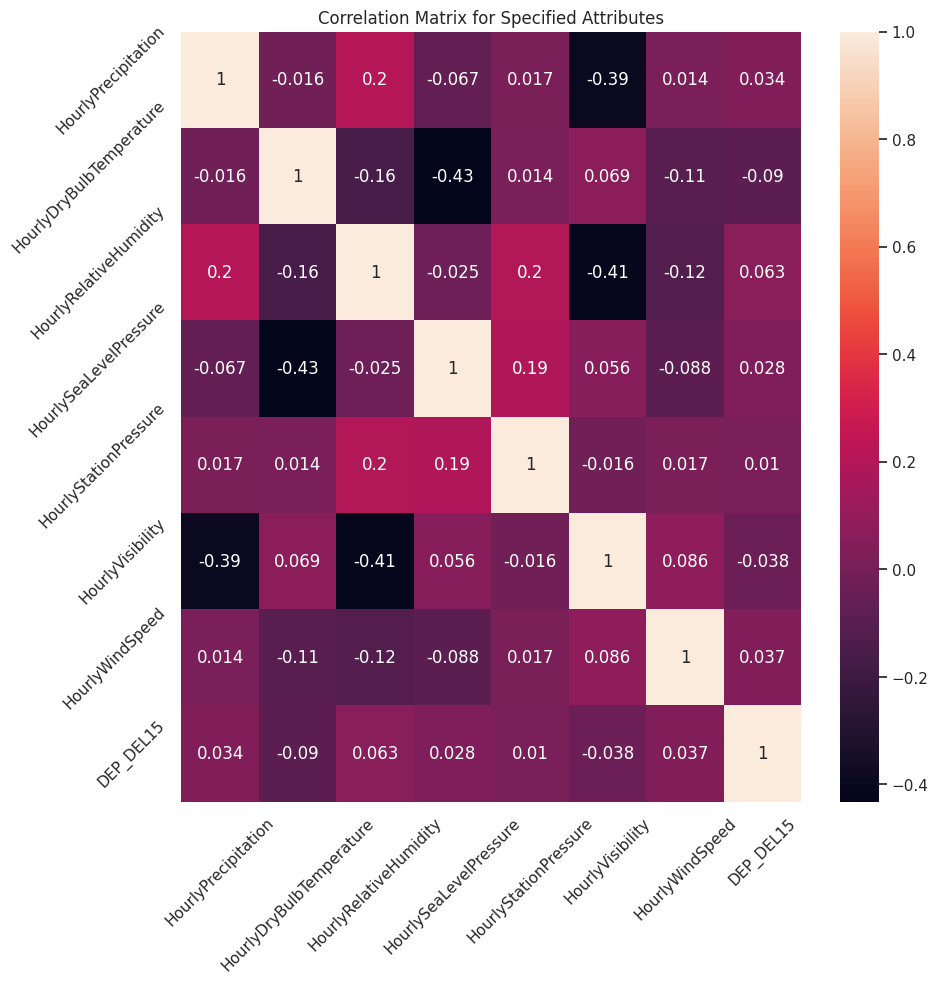

In [0]:
def plot_corr_matrix(correlations,attr,fig_no):
    fig=plt.figure(fig_no, figsize=(10,10))
    ax=fig.add_subplot(111)
    ax = sns.heatmap(correlations, annot=True)
    ax.set_title("Correlation Matrix for Specified Attributes")
    ax.set_xticklabels(attr, rotation = 45)
    ax.set_yticklabels(attr, rotation = 45)
    plt.show()

plot_corr_matrix(corrmatrix, weather_features, 234)

# Dimensionality Reduction and One-Hot Encoding

In [0]:
# join the airport and carrier information and perform OHE
from pyspark.ml.feature import VectorAssembler, StandardScaler, StringIndexer, OneHotEncoder, PCA

In [0]:
def ApplyOHE(df, col):
    """
        helper function to apply OHE
    """  
    # StringIndexer Initialization
    indexer = StringIndexer(inputCol=col, outputCol=col+"_indexed")
    indexerModel = indexer.fit(df)

    # Transform the DataFrame using the fitted StringIndexer model
    indexed_df = indexerModel.transform(df_flights_3M_numeric_non_null)

    # apply OneHot Encoding to the indexed column
    encoder = OneHotEncoder(inputCol=col+"_indexed", outputCol=col+"_onehot")
    df = encoder.fit(indexed_df).transform(indexed_df)
    return df


df_flights_3M_numeric_non_null = ApplyOHE(df_flights_3M_numeric_non_null, 'airport_groups')
df_flights_3M_numeric_non_null = ApplyOHE(df_flights_3M_numeric_non_null, 'carrier_groups')

In [0]:
df_flights_3M_numeric_non_null.display()

OP_UNIQUE_CARRIER,origin_iata_code,origin_airport_name,origin_type,DEP_DEL15,HourlyPrecipitation,HourlyDryBulbTemperature,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWindSpeed,airport_groups,carrier_groups,airport_groups_indexed,airport_groups_onehot,carrier_groups_indexed,carrier_groups_onehot
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,55.0,59.0,30.26,30.24,10.0,14.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,46.0,42.0,30.34,30.31,10.0,6.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,60.0,78.0,30.28,30.25,10.0,7.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,1.0,0.01,75.0,84.0,30.21,30.18,10.0,6.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,49.0,38.0,30.3,30.28,10.0,8.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,53.0,59.0,30.05,30.02,7.0,11.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,43.0,80.0,30.22,30.19,10.0,11.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,78.0,62.0,30.1,30.07,10.0,9.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,1.0,0.0,36.0,59.0,30.46,30.43,10.0,24.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"
UA,MSY,Louis Armstrong New Orleans International Airport,large_airport,0.0,0.0,75.0,71.0,30.06,30.03,10.0,6.0,D,D,1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 3, indices -> List(1), values -> List(1.0))"


In [0]:
# random split the data 80/20
train, test = df_flights_3M_numeric_non_null.randomSplit([0.8,0.2], seed=535)

### PCA Component Search Using Explained Variance Plots

Of the 7 weather features, 4 principal components can explain greater than 80% of the total variance. Thus, we will set k to 4 and transformed our scaled features.

In [0]:
# Serialize the weather features
weather_features = ["HourlyPrecipitation", "HourlyDryBulbTemperature", 
                    "HourlyRelativeHumidity", "HourlySeaLevelPressure", 
                    "HourlyStationPressure", "HourlyVisibility",
                    "HourlyWindSpeed"]

assembler = VectorAssembler(inputCols=weather_features, outputCol="features")
trainDF_VA = assembler.transform(train)

scaler = StandardScaler(inputCol="features", outputCol="features_scaled")
scaler_fit = scaler.fit(trainDF_VA)
trainDF_VA = scaler_fit.transform(trainDF_VA)

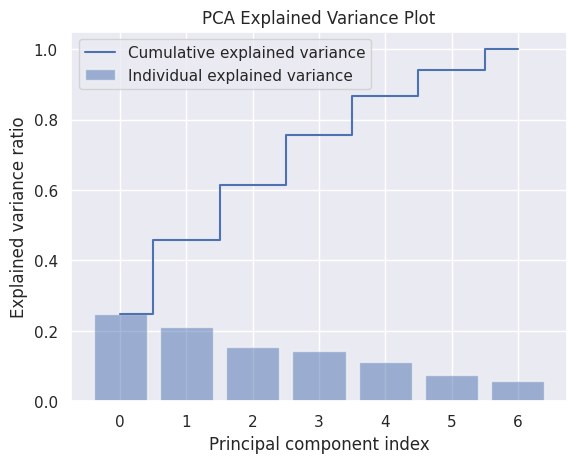

In [0]:
from pyspark.ml.feature import PCA
# begin PCA
pca = PCA(k=7, inputCol="features_scaled", outputCol='pca_features')
pca_applied = pca.fit(trainDF_VA)
exp_var_pca = pca_applied.explainedVariance
cum_sum_eigenvalues = np.cumsum(exp_var_pca)

# print("Begin Plotting Explaination of Variance")
# Create the visualization plot
plt.clf()
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, 
        alpha=0.5, align='center', 
        label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), 
        cum_sum_eigenvalues, 
        where='mid',
        label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.title(f"PCA Explained Variance Plot")
plt.show()

# Model training

In [0]:
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml import Pipeline

### Generate scaled and assembled DFs for train/test

In [0]:
# Create a pipeline to fully transform the data
STANDARD_FEATURE_COLNAME = "input_features"
def prepareDataSets(train, test, inputFeatures, onehotFeatures=[], doPCA=False, standardScale=False):
    '''
    Gets the train/test split, inputFeatures, and any one-hot encoded features and returns a train and test
    dataframe assembled ready to pipe into an Estimator (e.g. LogisticRegression) for training a model
    Optionally performs PCA and standard scaling on `inputFeatures`.
    '''

    outColva1 = "wFeatures"
    outCol = outColva1
    va1 = VectorAssembler(inputCols=inputFeatures, outputCol=outColva1)

    pipeline_stages = [va1]

    if standardScale:
        ## Standard Scaler
        outColScaler = "wFeatures_scaled"
        outCol = outColScaler
        standard_scaler = StandardScaler(inputCol=outColva1, outputCol=outColScaler)
        pipeline_stages.append(standard_scaler)

    if doPCA:
        ## PCA dimensionally reduction piece
        outColPCA = 'pca_wFeatures'
        outCol = outColPCA
        pca = PCA(k=4, inputCol=outColScaler, outputCol=outColPCA)
        pipeline_stages.append(pca)

    ## Serialize all remaining features
    complete_features = [outCol] + onehotFeatures
    final_assembler = VectorAssembler(inputCols=complete_features, outputCol=STANDARD_FEATURE_COLNAME)
    pipeline_stages.append(final_assembler)


    ## Setup the feature engineering pipeline and apply it onto the training data
    feature_engineered_pipeline = Pipeline(stages=pipeline_stages)

    ## apply the pipeline to the train and test set
    fitted_pipeline = feature_engineered_pipeline.fit(train)
    trainDF_VA = fitted_pipeline.transform(train)
    testDF_VA = fitted_pipeline.transform(test)

    return (trainDF_VA, testDF_VA)

In [0]:
## Weather features
weather_features = ["HourlyPrecipitation", "HourlyDryBulbTemperature", 
                    "HourlyRelativeHumidity", "HourlySeaLevelPressure", 
                    "HourlyStationPressure", "HourlyVisibility",
                    "HourlyWindSpeed"]
onehot_features = ["airport_groups_onehot", "carrier_groups_onehot"]

# Prepare data sets for model
trainDF_VA, testDF_VA = prepareDataSets(train, test, weather_features, onehot_features, True, True)

### Logistic regression baseline

In [0]:
## Run a simple logistic regression model and get training accuracy
## Fit Logistic Regression model
log_reg = LogisticRegression(family="binomial", featuresCol=STANDARD_FEATURE_COLNAME, labelCol="DEP_DEL15")
fitted_log_reg = log_reg.fit(trainDF_VA)

## Obtain the classification metrics for training set
train_results = fitted_log_reg.evaluate(trainDF_VA)

# Metrics
accuracy = train_results.accuracy
precision = train_results.weightedPrecision
recall =  train_results.weightedRecall
AUC =  train_results.areaUnderROC


print(f"Model Training Accuracy: {np.round(accuracy*100, 3)}")
print(f"Model Training Precision: {np.round(precision*100, 3)}")
print(f"Model Training Recall: {np.round(recall*100, 3)}")
print(f"Model Training AUC: {np.round(AUC, 3)}")

Model Training Accuracy: 80.222
Model Training Precision: 71.108
Model Training Recall: 80.222
Model Training AUC: 0.576


In [0]:
## Obtain the classification metrics for test set
test_results = fitted_log_reg.evaluate(testDF_VA)

# Metrics
accuracy = test_results.accuracy
precision = test_results.weightedPrecision
recall =  test_results.weightedRecall
AUC =  test_results.areaUnderROC

print(f"Model Test Accuracy: {np.round(accuracy*100, 3)}")
print(f"Model Test Precision: {np.round(precision*100, 3)}")
print(f"Model Test Recall: {np.round(recall*100, 3)}")
print(f"Model Test AUC: {np.round(AUC, 3)}")

Model Test Accuracy: 80.275
Model Test Precision: 71.306
Model Test Recall: 80.275
Model Test AUC: 0.574


#### K-fold validation

In [0]:
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import MulticlassClassificationEvaluator, BinaryClassificationEvaluator
from pyspark.mllib.evaluation import BinaryClassificationMetrics

paramGrid = ParamGridBuilder() \
    .addGrid(log_reg.elasticNetParam, [0.0, 0.5, 1.0]) \
    .addGrid(log_reg.maxIter, [1, 5, 10, 20, 50]) \
    .addGrid(log_reg.regParam, [0.5, 0.1, 0.01]) \
    .build()

cv_evaluator = BinaryClassificationEvaluator(labelCol="DEP_DEL15")
crossval = CrossValidator(estimator=log_reg, estimatorParamMaps=paramGrid, evaluator=cv_evaluator, numFolds=5)

# Run the cross validation
cvModel = crossval.fit(trainDF_VA)

lrpredictions = cvModel.transform(testDF_VA)
lrpredictions.select("prediction", "DEP_DEL15", "input_features").show(5)


+----------+---------+--------------------+
|prediction|DEP_DEL15|      input_features|
+----------+---------+--------------------+
|       0.0|      0.0|[-13.496693209492...|
|       0.0|      0.0|[-13.261738387029...|
|       0.0|      0.0|[-13.379412957471...|
|       0.0|      0.0|[-13.846257101253...|
|       0.0|      0.0|[-14.178575988869...|
+----------+---------+--------------------+
only showing top 5 rows

Accuracy: 0.5741858771414249


---------------------------------------------------------------------------
AnalysisException                         Traceback (most recent call last)
File <command-3631218846932913>:20
     18 lrpredictions.select("prediction", "DEP_DEL15", "input_features").show(5)
     19 print('Accuracy:', cv_evaluator.evaluate(lrpredictions))
---> 20 print('AUC:', BinaryClassificationMetrics(lrpredictions['label','prediction'].rdd).areaUnderROC)

File /databricks/spark/python/pyspark/instrumentation_utils.py:48, in _wrap_function.<locals>.wrapper(*args, **kwargs)
     46 start = time.perf_counter()
     47 try:
---> 48     res = func(*args, **kwargs)
     49     logger.log_success(
     50         module_name, class_name, function_name, time.perf_counter() - start, signature
     51     )
     52     return res

File /databricks/spark/python/pyspark/sql/dataframe.py:3022, in DataFrame.__getitem__(self, item)
   3020     return self.filter(item)
   3021 elif isinstance(item, (list, tuple)):
-> 302

In [0]:
print('Accuracy:', cv_evaluator.evaluate(lrpredictions))
print('AUC:', BinaryClassificationMetrics(lrpredictions['DEP_DEL15','prediction'].rdd).areaUnderROC)

Accuracy: 0.5741831806809828


/databricks/spark/python/pyspark/sql/context.py:165: FutureWarning:

Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.



AUC: 0.5566683878920625


### Decision Tree baseline

In [0]:
# Create datasets for Decision Tree without PCA and scaling
trainDF_VA, testDF_VA = prepareDataSets(train, test, weather_features, onehot_features, False, False)

In [0]:
## Tun a simple Decision Tree model and get training metrics
## Fit Decision Tree model
decision_tree = DecisionTreeClassifier(featuresCol=STANDARD_FEATURE_COLNAME, labelCol="DEP_DEL15")
fitted_decision_tree = decision_tree.fit(trainDF_VA)

In [0]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator, BinaryClassificationEvaluator

# Make predictions.
predictions = fitted_decision_tree.transform(testDF_VA)

# Select example rows to display.
predictions.select("prediction", "DEP_DEL15", "input_features").show(5)

# Select (prediction, true label) and compute test error
evaluatorMulti = MulticlassClassificationEvaluator(labelCol="DEP_DEL15", predictionCol="prediction")
evaluator = BinaryClassificationEvaluator(labelCol="DEP_DEL15", rawPredictionCol="prediction", metricName='areaUnderROC')

accuracy = evaluatorMulti.evaluate(predictions, {evaluator.metricName: "accuracy"})
precision = evaluatorMulti.evaluate(predictions, {evaluator.metricName: "weightedPrecision"})
recall =  evaluatorMulti.evaluate(predictions, {evaluator.metricName: "weightedRecall"})
AUC =  evaluator.evaluate(predictions)


print(f"Model Test Accuracy: {np.round(accuracy*100, 3)}")
print(f"Model Test Precision: {np.round(precision*100, 3)}")
print(f"Model Test Recall: {np.round(recall*100, 3)}")
print(f"Model Test AUC: {np.round(AUC, 3)}")

+----------+---------+--------------------+
|prediction|DEP_DEL15|      input_features|
+----------+---------+--------------------+
|       0.0|      0.0|[0.0,39.0,55.0,30...|
|       0.0|      0.0|[0.0,40.0,47.0,30...|
|       0.0|      0.0|[0.0,41.0,51.0,30...|
|       0.0|      0.0|[0.0,41.0,76.0,30...|
|       0.0|      0.0|[0.0,41.0,82.0,30...|
+----------+---------+--------------------+
only showing top 5 rows

Model Test Accuracy: 71.911
Model Test Precision: 71.911
Model Test Recall: 71.911
Model Test AUC: 0.504


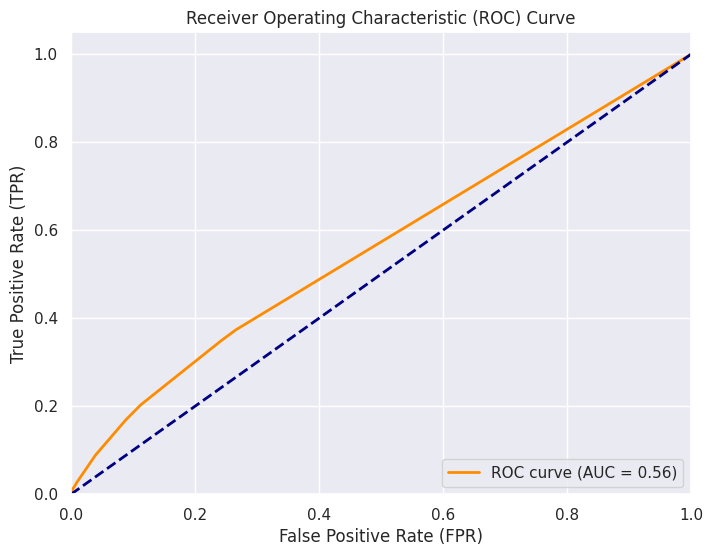

AUC: 0.561


In [0]:
from sklearn.metrics import roc_curve, auc

# Convert probability values to a NumPy array
probs = np.array(predictions.select('probability').rdd.map(lambda x: x[0][1]).collect())
labels = np.array(predictions.select('DEP_DEL15').rdd.map(lambda x: x[0]).collect())

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(labels, probs)

# Calculate the AUC
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

print(f"AUC: {roc_auc:.3f}")
# Note: 0.5 indicates a model that is not performing much better than random chance